In [25]:
#%% Imports
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt

# Import "local" packages
import hyspec_io, hyspec_ml, image_render, preprocess 

In [26]:
# Parameters
nir_band = (730,850)

In [27]:
#%% Paths
tmp_save_dir = Path('/media/mha114/Massimal2/Massimal/X_TemporaryDeletableFiles/PrelimSkalmenDeglint')
im_paths = ['/media/mha114/Massimal2/Massimal/Smola_Skalmen/Hyperspectral/20230620/2a_Rrs/Skardskjaringen_Pika_L_31-Crop Wavelengths.bip.hdr',
            '/media/mha114/Massimal2/Massimal/Smola_Skalmen/Hyperspectral/20230620/2a_Rrs/Skardskjaringen_Pika_L_32-Crop Wavelengths.bip.hdr', # første eksempel
            '/media/mha114/Massimal2/Massimal/Smola_Skalmen/Hyperspectral/20230620/2a_Rrs/Skardskjaringen_Pika_L_79-Crop Wavelengths.bip.hdr', # dyp sand midt i bildet
            '/media/mha114/Massimal2/Massimal/Smola_Skalmen/Hyperspectral/20230620/2a_Rrs/Skardskjaringen_Pika_L_81-Crop Wavelengths.bip.hdr',
            '/media/mha114/Massimal2/Massimal/Smola_Maholmen/Hyperspectral/20230621/2a_Rrs/Maholmen_02_Pika_L_24-Crop Wavelengths.bip.hdr',
            '/media/mha114/Massimal2/Massimal/Smola_Maholmen/Hyperspectral/20230621/2a_Rrs/Maholmen_02_Pika_L_30-Crop Wavelengths.bip.hdr', # godt eksempel
            '/media/mha114/Massimal2/Massimal/Smola_Maholmen/Hyperspectral/20230621/2a_Rrs/Maholmen_02_Pika_L_42-Crop Wavelengths.bip.hdr',
            '/media/mha114/Massimal2/Massimal/Smola_Maholmen/Hyperspectral/20230621/2a_Rrs/Maholmen_03_Pika_L_20-Crop Wavelengths.bip.hdr', # godt eksempel
            '/media/mha114/Massimal2/Massimal/Smola_Maholmen/Hyperspectral/20230621/2a_Rrs/Maholmen_03_Pika_L_25-Crop Wavelengths.bip.hdr',
            '/media/mha114/Massimal2/Massimal/Smola_Maholmen/Hyperspectral/20230621/2a_Rrs/Maholmen_03_Pika_L_32-Crop Wavelengths.bip.hdr'] # godt eksempel
im_paths = [Path(p) for p in im_paths]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


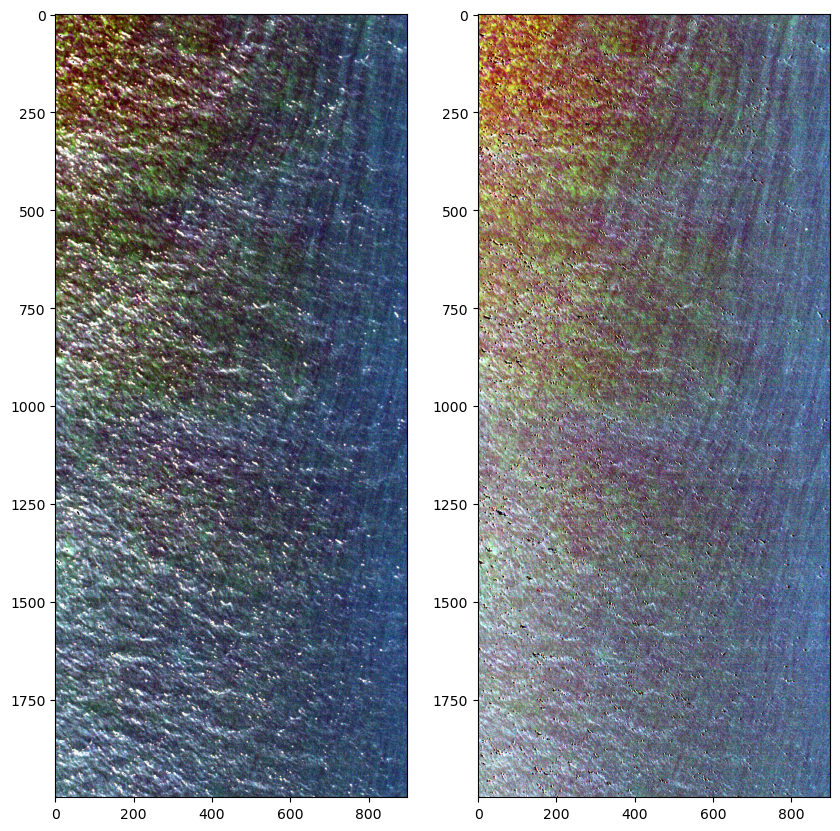

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


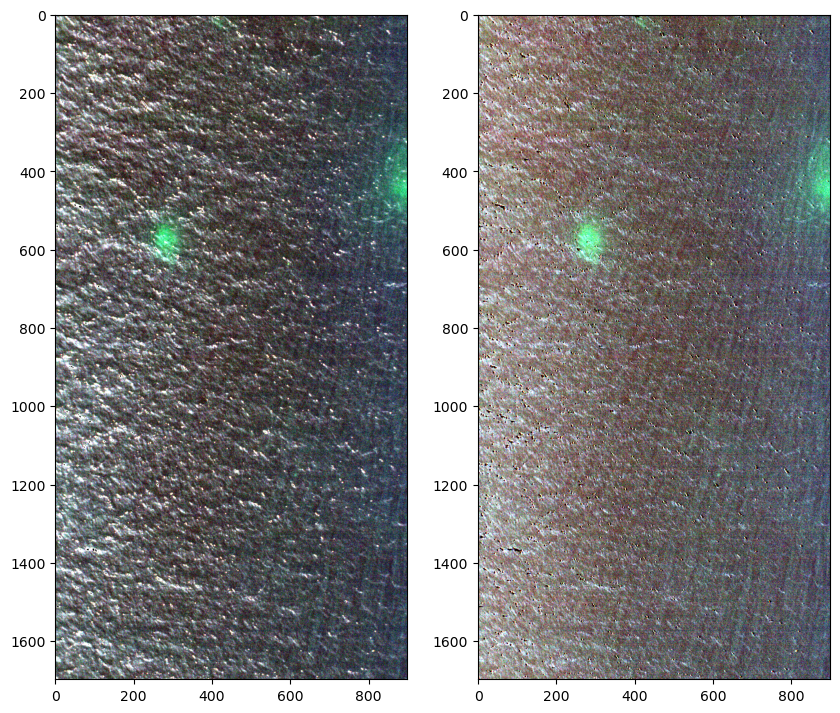

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


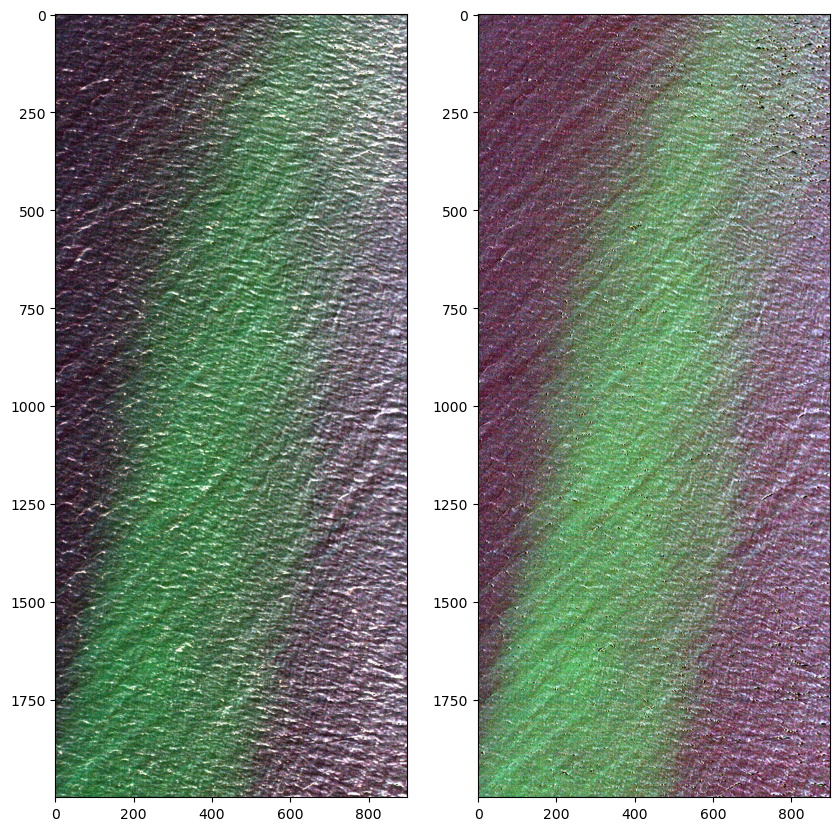

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


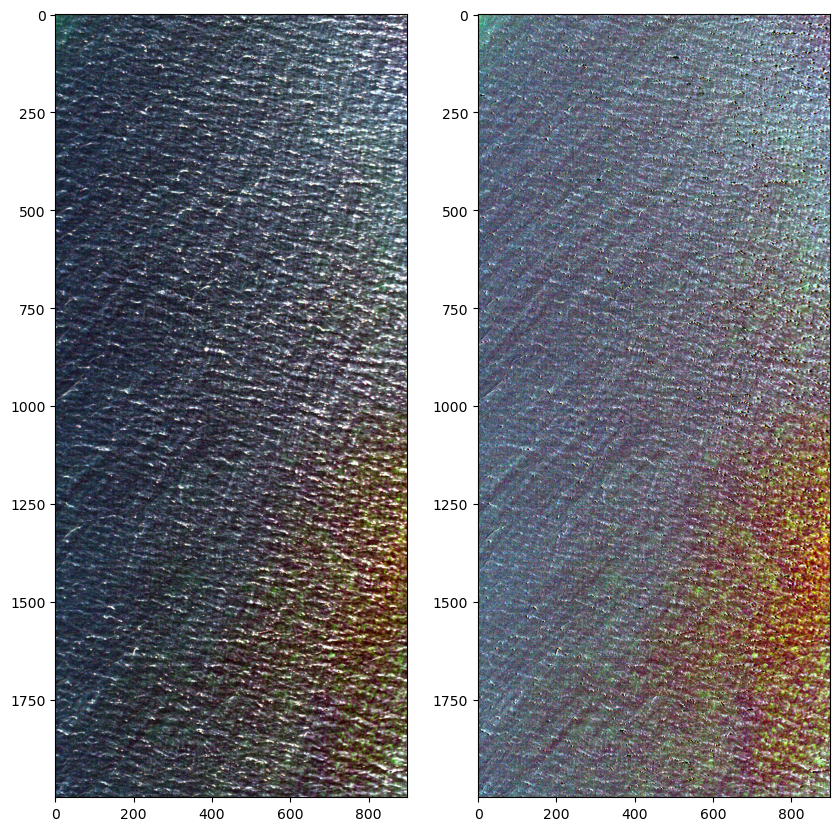

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


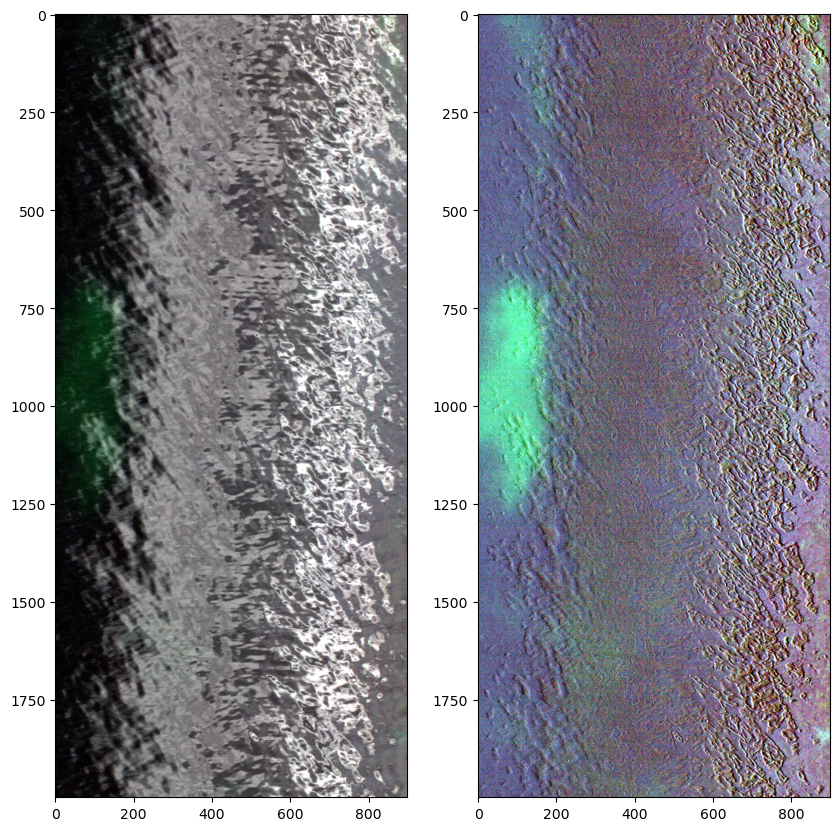

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


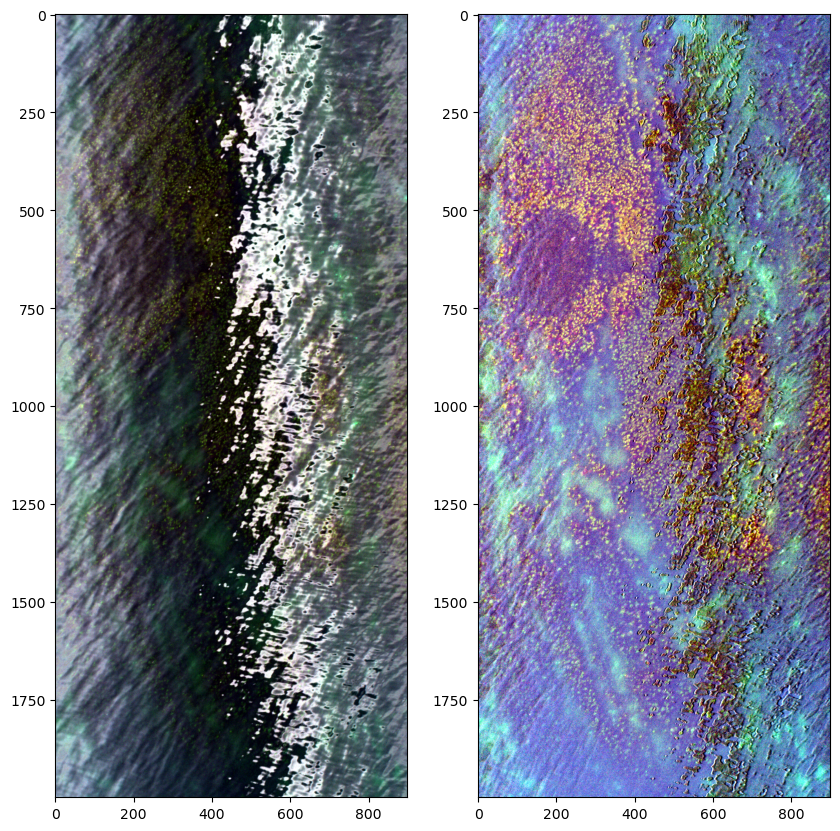

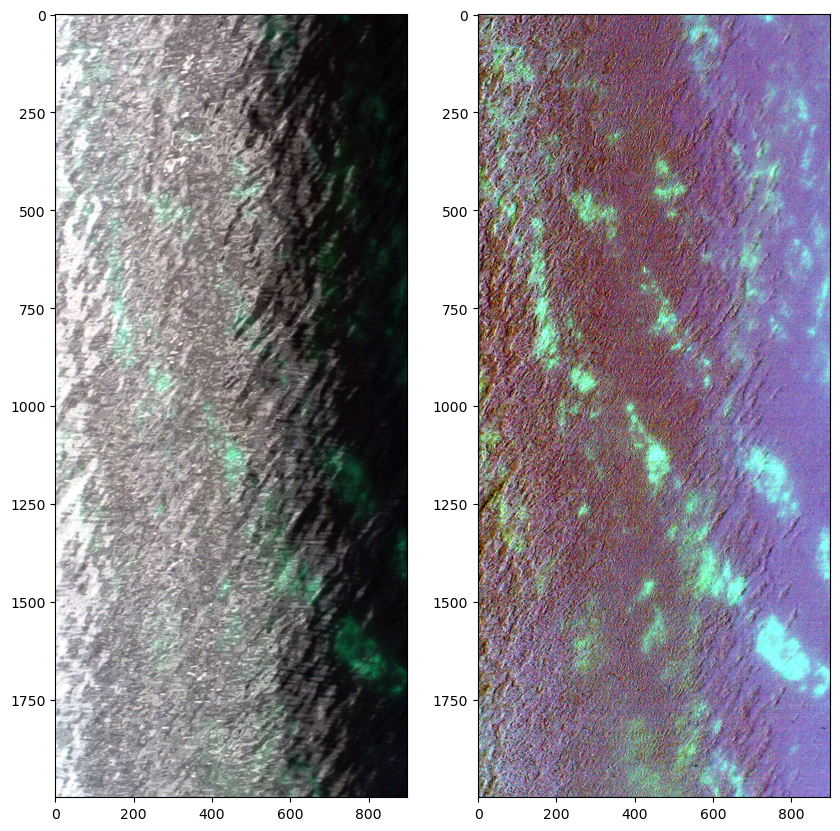

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


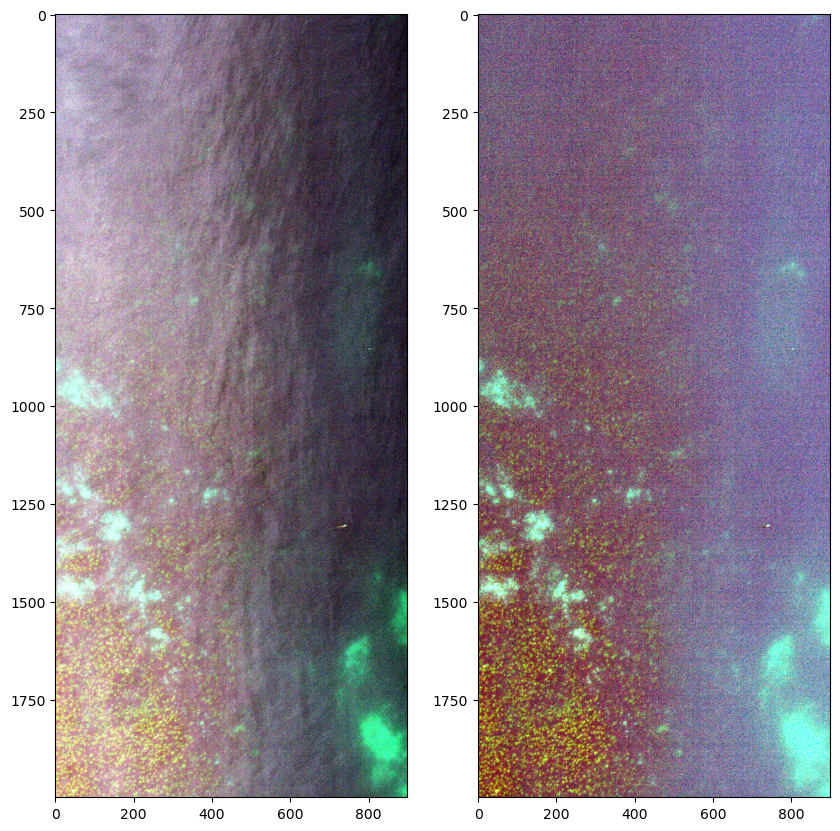

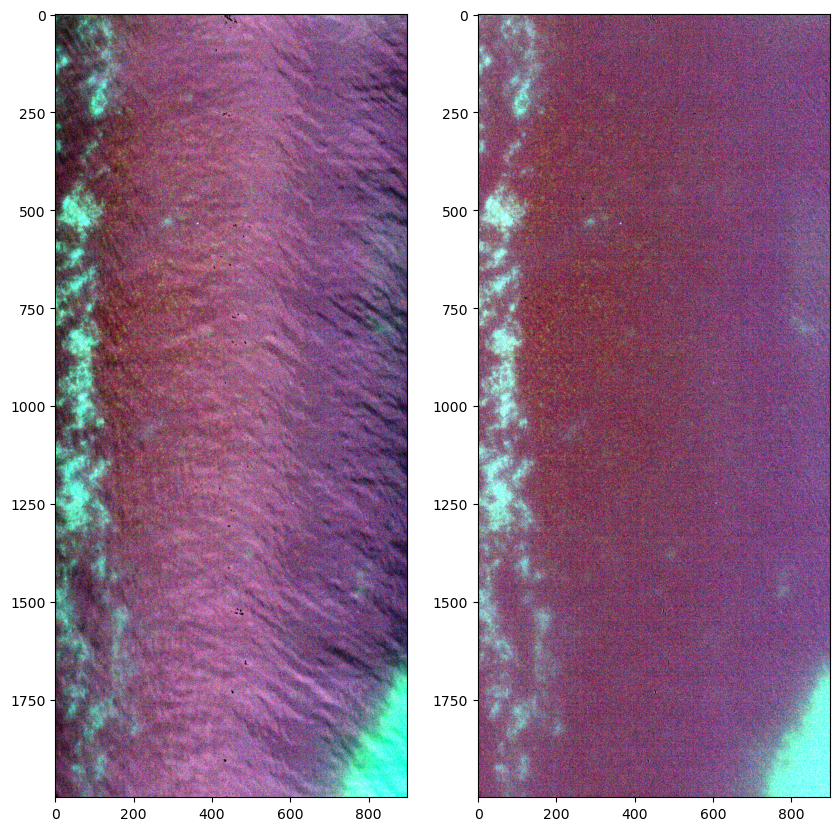

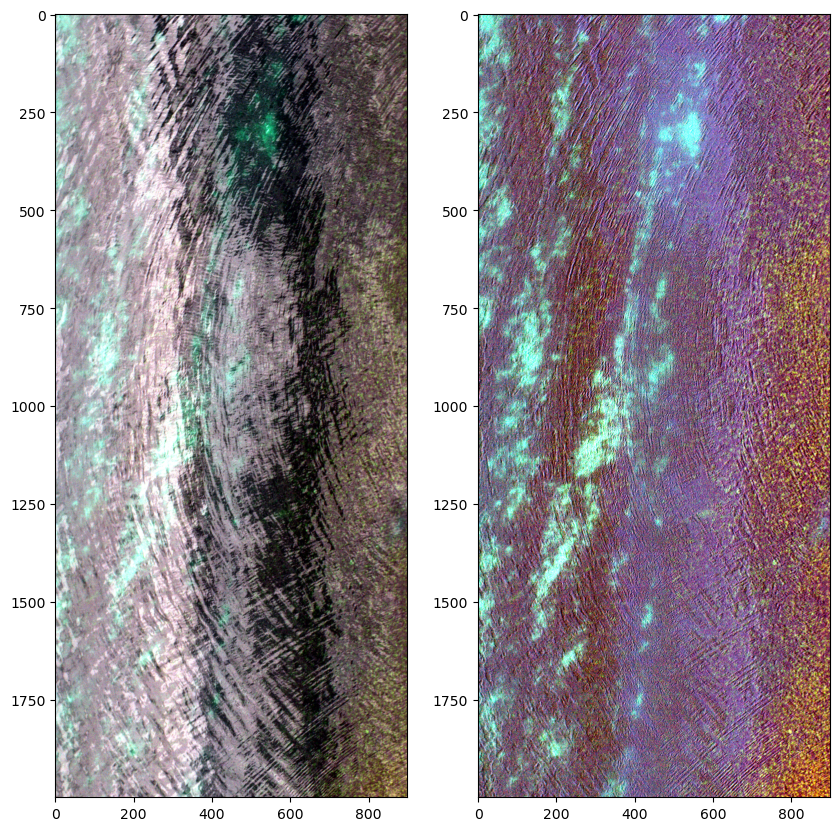

In [28]:
# Show flat spec sun glint corrected images
for im_path in im_paths:
    (image,wl,rgb_ind,metadata) = hyspec_io.load_envi_image(im_path)
    image_noglint = preprocess.remove_glint_flatspec(image,wl,nir_band=nir_band)
    fig,ax = plt.subplots(ncols=2,figsize=(10,12))
    ax[0].imshow(image_render.percentile_stretch(image[:,:,rgb_ind]))
    ax[1].imshow(image_render.percentile_stretch(image_noglint[:,:,rgb_ind]))
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


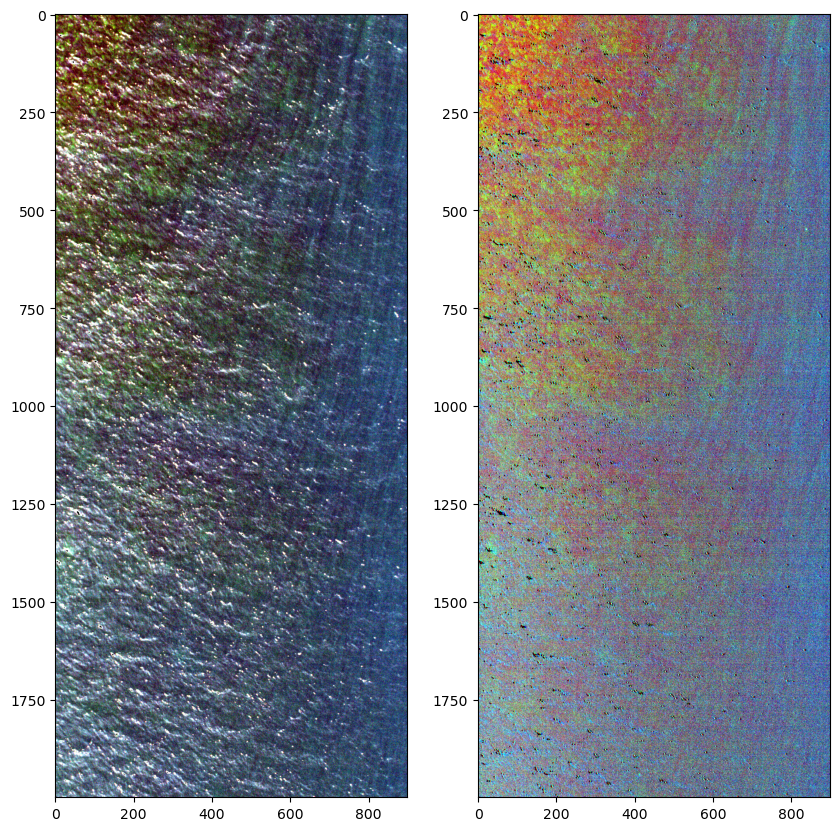

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


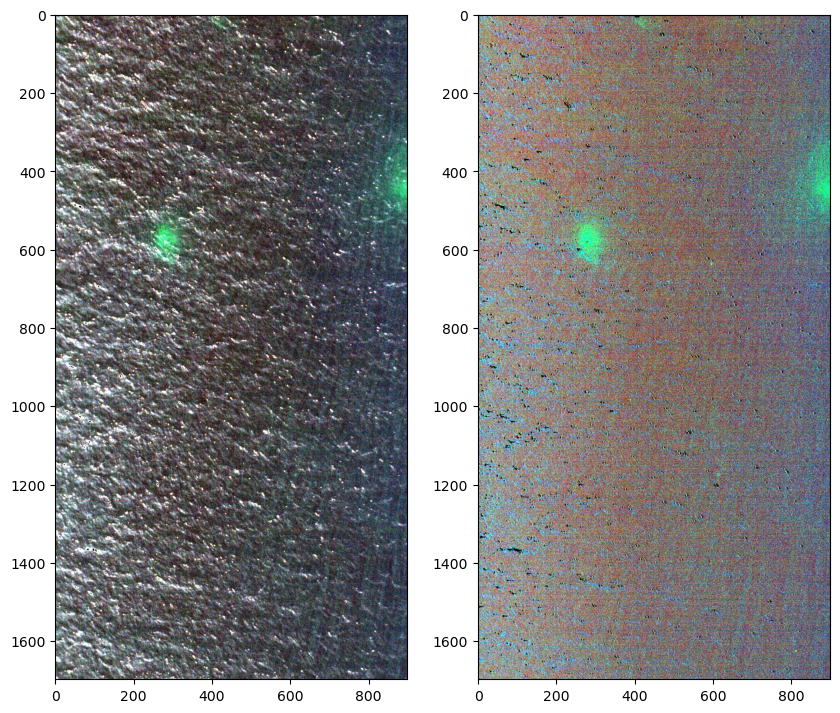

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


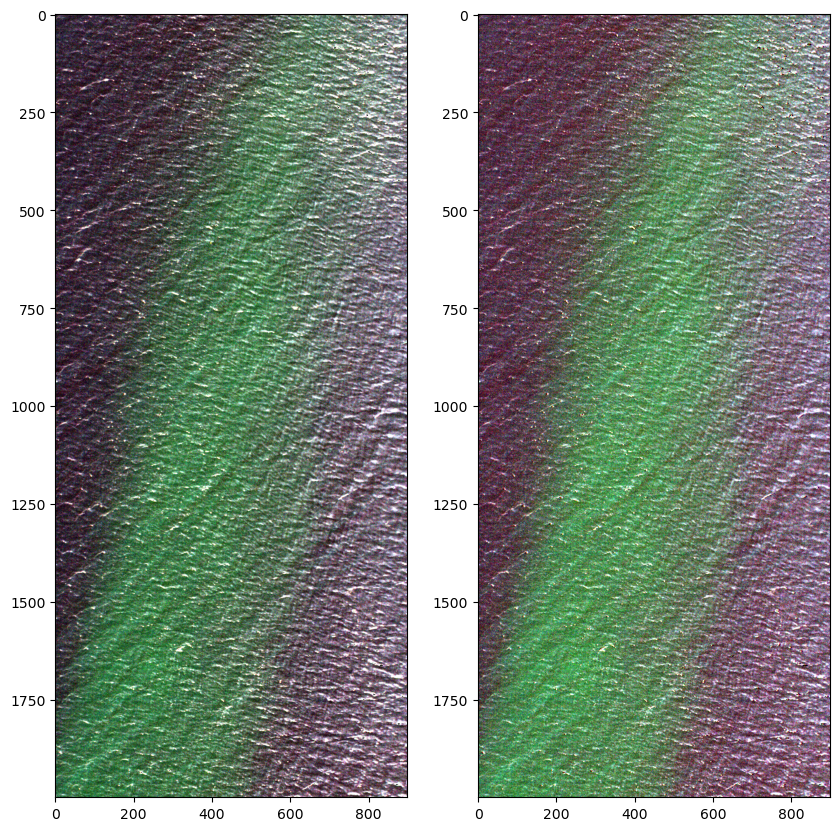

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


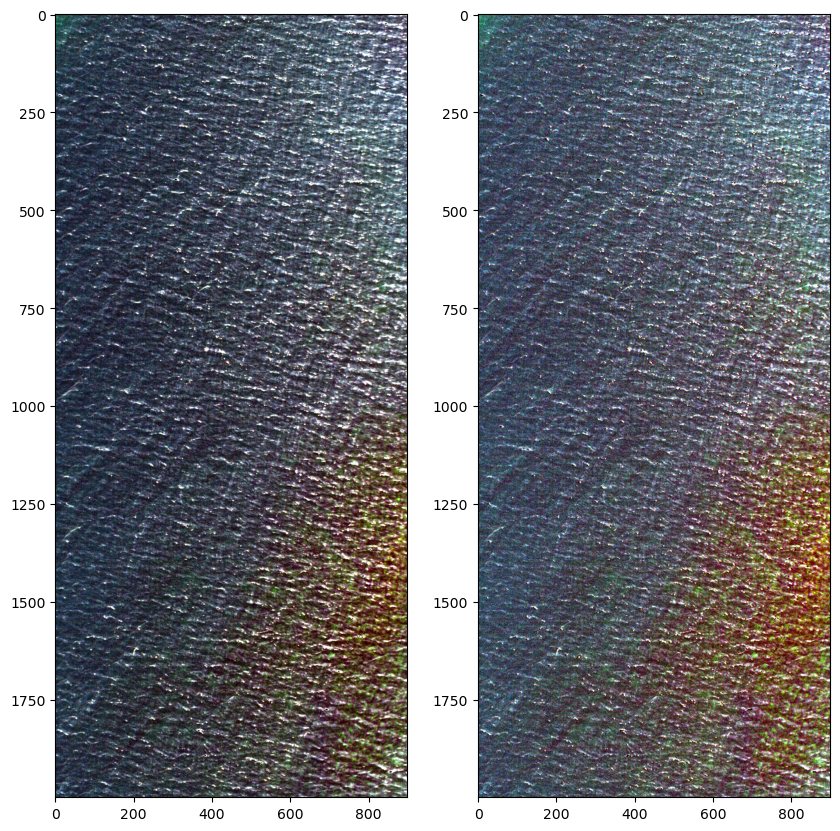

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


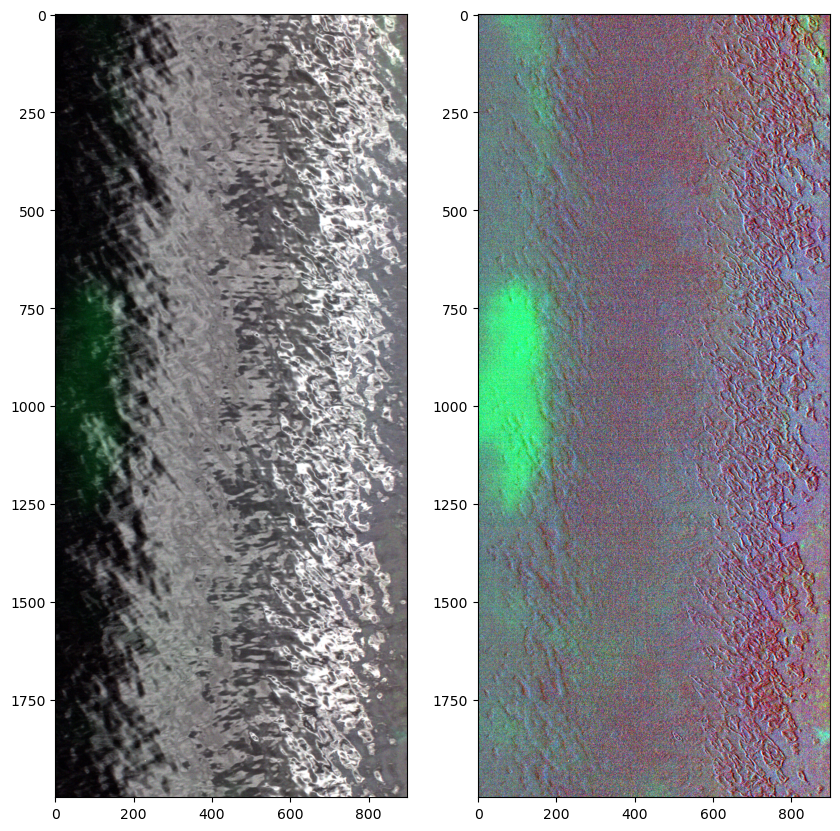

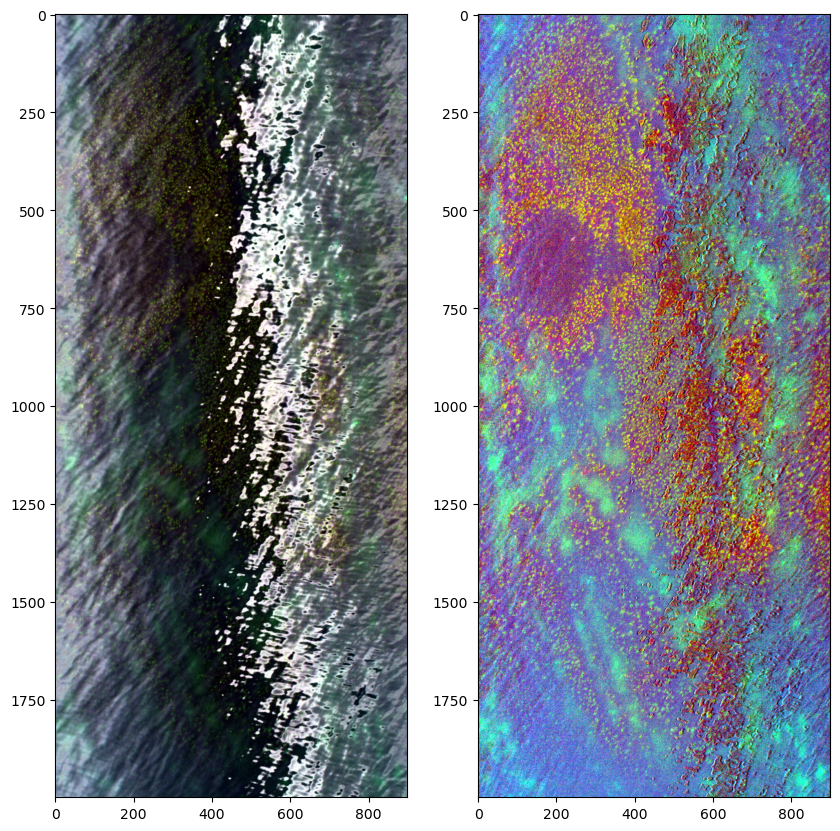

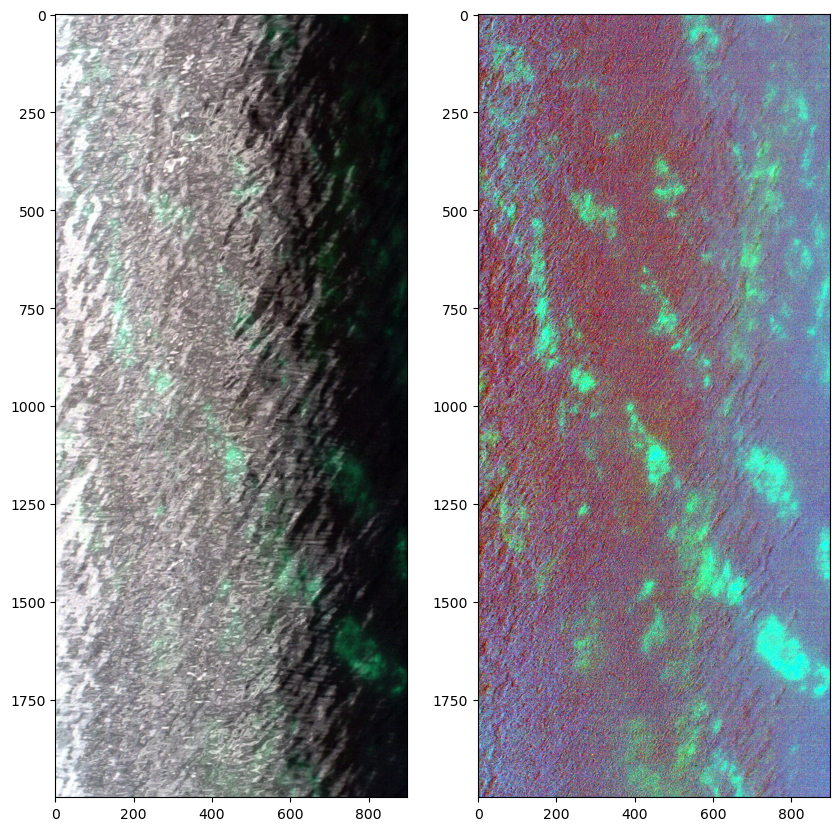

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


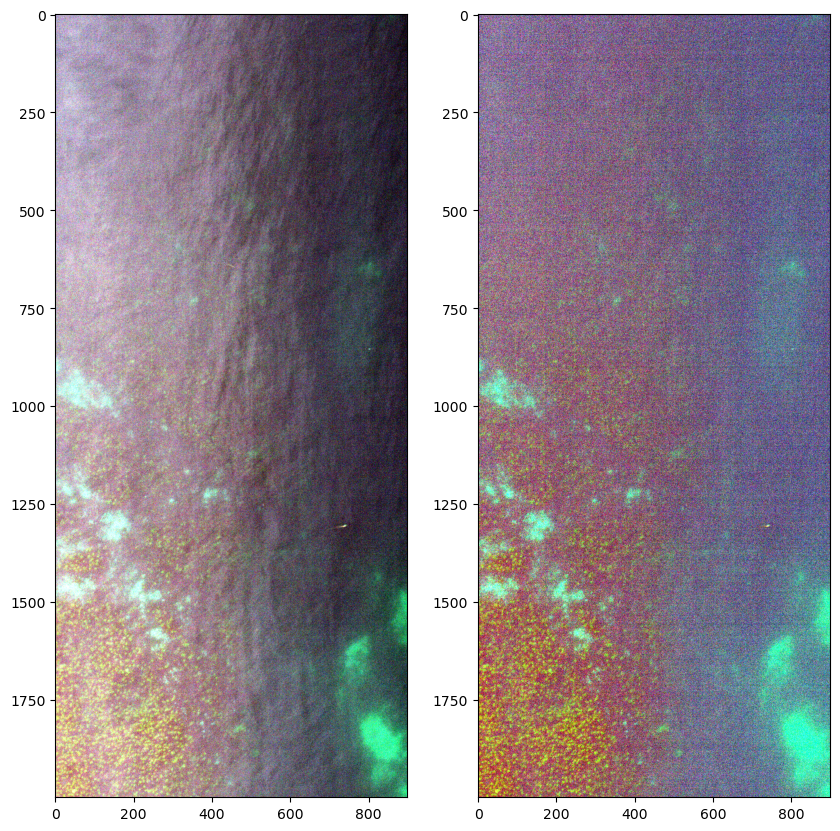

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


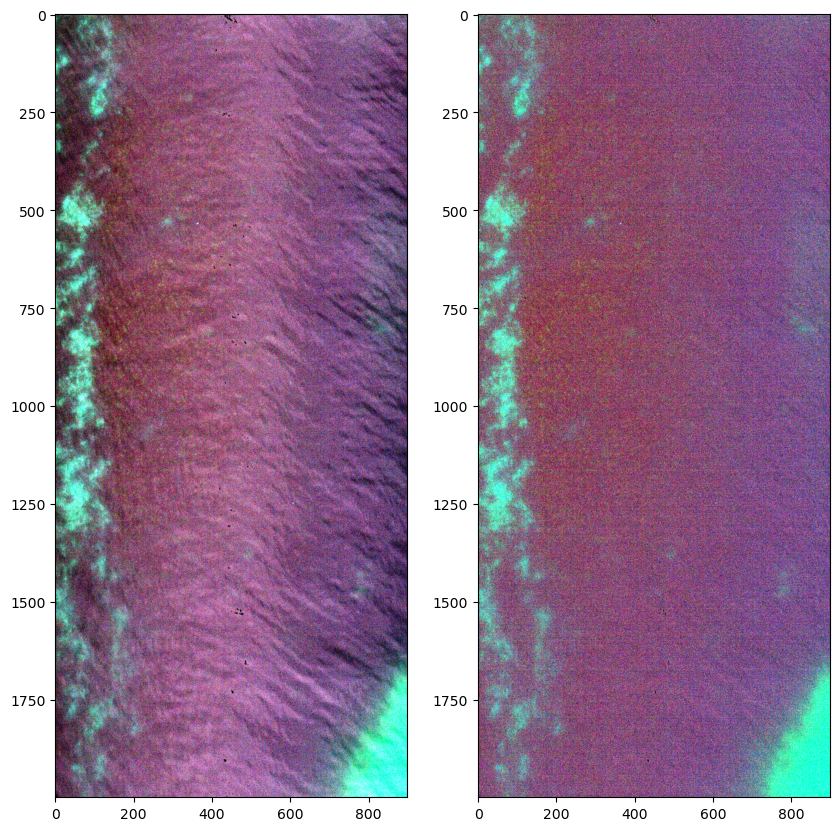

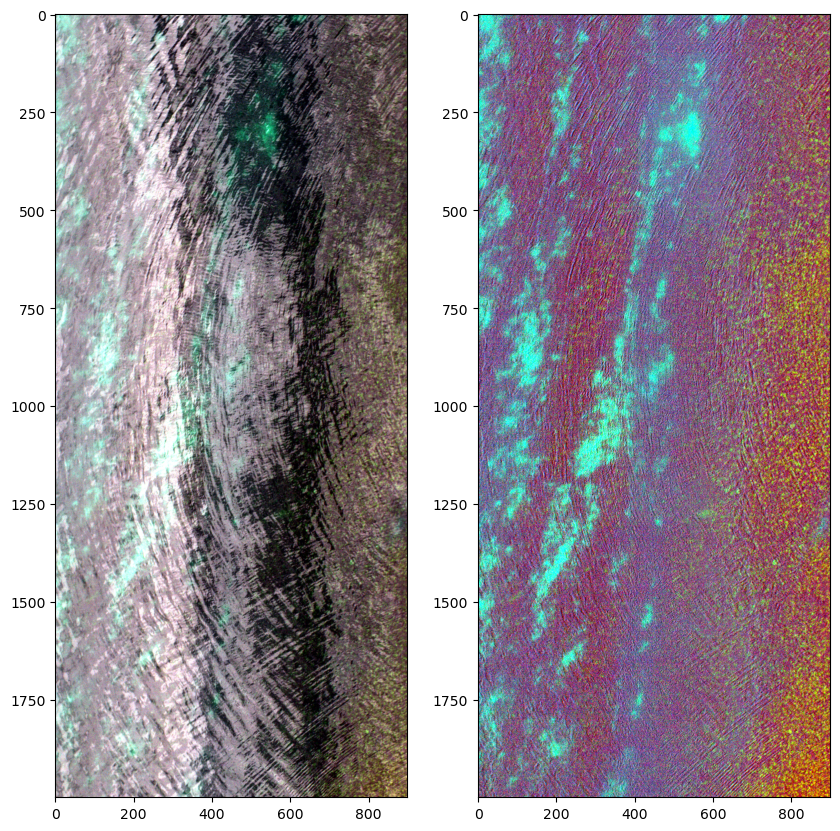

In [31]:
# Show PCA sun glint corrected images for comparison
for im_path in im_paths:
    (image,wl,rgb_ind,metadata) = hyspec_io.load_envi_image(im_path)

    pcasgc_dir = im_path.parent.parent / '3a_Rrs_SGC' 
    filename_start, filename_end = im_path.name.split('.',maxsplit=1)
    im_path_pcasgc = pcasgc_dir / f'{filename_start}-PCASGC.{filename_end}'
    image_noglint,_,_,_ = hyspec_io.load_envi_image(im_path_pcasgc)

    fig,ax = plt.subplots(ncols=2,figsize=(10,12))
    ax[0].imshow(image_render.percentile_stretch(image[:,:,rgb_ind]))
    ax[1].imshow(image_render.percentile_stretch(image_noglint[:,:,rgb_ind]))
    plt.show()

# Notes on flat spectrum SGC vs PCA SGC
- In many cases, the visual result is quite similar.
- In some cases, possibly in overcast weather, there are artifacts with sharper edges in the flat spec SGC images. 
- Flat spec SGC has the advantage of minimal distortion of the original spectrum (only "flat offset").
- For visual interpretation, PCASGC images are deemed slightly better. 
- For machine learning across multiple locations, flat spec SGC probably yields spectra with more consistent scales (NIR always set to approx. zero).
- Spectral shapes are very similar when comparing the two methods, except in cases with extreme sun glint, where PCA-SGC results in more distorted spectra. However, in pixels with extreme sun glint, there is often no useful spectral information anyway. 

In [30]:
# filename_start, filename_end = im_path.name.split('.',maxsplit=1)
# save_file_path = tmp_save_dir / (filename_start + '_flatspecSGC.' + filename_end)
# hyspec_io.save_envi_image(str(save_file_path),image_noglint,metadata)